In [1]:
#Import all libraries
import numpy as np
import pandas as pd
import nltk
import matplotlib.pyplot as plt
from wordcloud import WordCloud
from wordcloud import WordCloud, STOPWORDS
import string
import seaborn as sns
import plotly.graph_objects as go
from sklearn.decomposition import PCA
from gensim.models import Word2Vec, FastText
import warnings
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.pipeline import Pipeline
from sklearn.metrics import accuracy_score, confusion_matrix , classification_report
from sklearn.preprocessing import LabelEncoder
warnings.filterwarnings('ignore')

In [2]:
#creating word cloud for given corpus  
def make_wordcloud(corpus , stopword):
    word_cloud = WordCloud(
            width=3000,
            height=2000,
            random_state=1,
            background_color="black",
            colormap="Pastel1",
            collocations=False,
            stopwords=stopword,
            ).generate(corpus)
    return word_cloud

In [3]:
#This function swaps 2 columns inside the dataframe
def swap_columns(df, col1, col2):
    col_list = list(df.columns)
    x, y = col_list.index(col1), col_list.index(col2)
    col_list[y], col_list[x] = col_list[x], col_list[y]
    df = df[col_list]
    return df

In [4]:
#This function removes punctuation from string
def remove_punctuations(text):
    for punctuation in string.punctuation:
        text = text.replace(punctuation, '')
    return text

In [5]:
#Reading dataset
Email_dataset = pd.read_csv("/kaggle/input/spam-mails-dataset/spam_ham_dataset.csv")

In [6]:
#Show dataset
Email_dataset.head()

,Unnamed: 0,label,text,label_num
0,605,ham,Subject: enron methanol ; meter # : 988291\r\n...,0
1,2349,ham,"Subject: hpl nom for january 9 , 2001\r\n( see...",0
2,3624,ham,"Subject: neon retreat\r\nho ho ho , we ' re ar...",0
3,4685,spam,"Subject: photoshop , windows , office . cheap ...",1
4,2030,ham,Subject: re : indian springs\r\nthis deal is t...,0


In [7]:
s=Email_dataset["label"].value_counts()
s

ham     3672
spam    1499
Name: label, dtype: int64

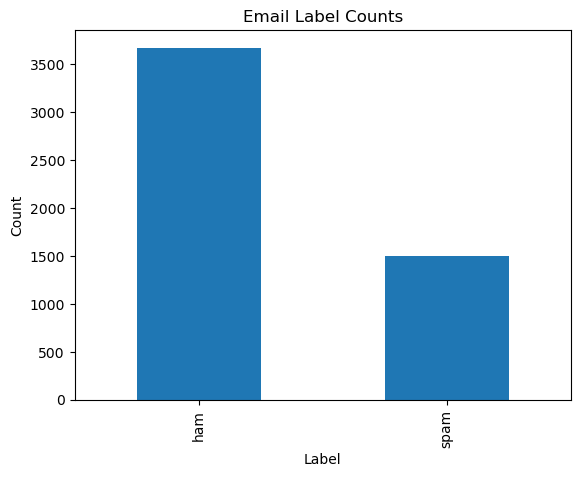

In [8]:
# create a bar chart
s.plot.bar()

# set the title and axis labels
plt.title("Email Label Counts")
plt.xlabel("Label")
plt.ylabel("Count")

# display the chart
plt.show()

In [9]:
#Dropping columns that are not needed
Email_dataset = Email_dataset.drop('Unnamed: 0', axis=1)
Email_dataset = Email_dataset.drop('label', axis=1)

In [10]:
Email_dataset.head()

,text,label_num
0,Subject: enron methanol ; meter # : 988291\r\n...,0
1,"Subject: hpl nom for january 9 , 2001\r\n( see...",0
2,"Subject: neon retreat\r\nho ho ho , we ' re ar...",0
3,"Subject: photoshop , windows , office . cheap ...",1
4,Subject: re : indian springs\r\nthis deal is t...,0


In [11]:
#Creating a new feature, extracting subject of each email
subjects = []
for i in range(len(Email_dataset)):
    ln = Email_dataset["text"][i]
    line = ""
    for i in ln:
        if(i == '\r'):
            break
        line = line + i
    line = line.replace("Subject" , "")
    subjects.append(line)

In [12]:
Email_dataset['Subject'] = subjects

In [13]:
#Renaming the dataframe columns
Email_dataset.columns = ["Email_text" , "Labels" , "Email_Subject"]

In [14]:
Email_dataset.head()

,Email_text,Labels,Email_Subject
0,Subject: enron methanol ; meter # : 988291\r\n...,0,: enron methanol ; meter # : 988291
1,"Subject: hpl nom for january 9 , 2001\r\n( see...",0,": hpl nom for january 9 , 2001"
2,"Subject: neon retreat\r\nho ho ho , we ' re ar...",0,: neon retreat
3,"Subject: photoshop , windows , office . cheap ...",1,": photoshop , windows , office . cheap . main ..."
4,Subject: re : indian springs\r\nthis deal is t...,0,: re : indian springs


In [15]:
#Swapping the dataframe columns 
Email_dataset = swap_columns(Email_dataset, 'Labels', 'Email_Subject')

In [16]:
Email_dataset.head()

,Email_text,Email_Subject,Labels
0,Subject: enron methanol ; meter # : 988291\r\n...,: enron methanol ; meter # : 988291,0
1,"Subject: hpl nom for january 9 , 2001\r\n( see...",": hpl nom for january 9 , 2001",0
2,"Subject: neon retreat\r\nho ho ho , we ' re ar...",: neon retreat,0
3,"Subject: photoshop , windows , office . cheap ...",": photoshop , windows , office . cheap . main ...",1
4,Subject: re : indian springs\r\nthis deal is t...,: re : indian springs,0


In [17]:
#Converting all strings to lowercase
Email_dataset['Email_Subject'] = Email_dataset['Email_Subject'].str.lower()
Email_dataset['Email_text'] = Email_dataset['Email_text'].str.lower()

In [18]:
#Removing Punctuation from the data
Email_dataset['Email_Subject'] = Email_dataset['Email_Subject'].apply(remove_punctuations)
Email_dataset['Email_text'] = Email_dataset['Email_text'].apply(remove_punctuations)

In [19]:
Email_dataset.head()

,Email_text,Email_Subject,Labels
0,subject enron methanol meter 988291\r\nthis...,enron methanol meter 988291,0
1,subject hpl nom for january 9 2001\r\n see at...,hpl nom for january 9 2001,0
2,subject neon retreat\r\nho ho ho we re aroun...,neon retreat,0
3,subject photoshop windows office cheap mai...,photoshop windows office cheap main trending,1
4,subject re indian springs\r\nthis deal is to ...,re indian springs,0


In [20]:
#Creting seprate dataset for Spam and Non Spam emails, to perform analysis 
Spam = pd.DataFrame(columns = ['Email_text', 'Email_Subject', 'Labels'])
Non_Spam = pd.DataFrame(columns = ['Email_text', 'Email_Subject', 'Labels'])

In [21]:
#Creating Non_Spam email dataset 
for i in range(len(Email_dataset)):
    if(Email_dataset['Labels'][i] == 0):
        new_row = {'Email_text':Email_dataset['Email_text'][i], 'Email_Subject':Email_dataset['Email_Subject'][i], 'Labels':Email_dataset['Labels'][i]}
        Non_Spam = Non_Spam.append(new_row, ignore_index=True)

In [22]:
#Creating Spam email dataset 
for i in range(len(Email_dataset)):
    if(Email_dataset['Labels'][i] == 1):
        new_row = {'Email_text':Email_dataset['Email_text'][i], 'Email_Subject':Email_dataset['Email_Subject'][i], 'Labels':Email_dataset['Labels'][i]}
        Spam = Spam.append(new_row, ignore_index=True)

In [23]:
Spam.head()

,Email_text,Email_Subject,Labels
0,subject photoshop windows office cheap mai...,photoshop windows office cheap main trending,1
1,subject looking for medication we re the bes...,looking for medication we re the best source,1
2,subject vocable rnd word asceticism\r\nvcsc ...,vocable rnd word asceticism,1
3,subject report 01405 \r\nwffur attion brom est...,report 01405,1
4,subject vic odin n ow\r\nberne hotbox carnal...,vic odin n ow,1


In [24]:
Non_Spam.head()

,Email_text,Email_Subject,Labels
0,subject enron methanol meter 988291\r\nthis...,enron methanol meter 988291,0
1,subject hpl nom for january 9 2001\r\n see at...,hpl nom for january 9 2001,0
2,subject neon retreat\r\nho ho ho we re aroun...,neon retreat,0
3,subject re indian springs\r\nthis deal is to ...,re indian springs,0
4,subject ehronline web address change\r\nthis m...,ehronline web address change,0


In [25]:
#creating stopwords corpus
more_stopwords = {'re' , 's' , 'subject','hpl','hou','enron'}
STOPWORDS = STOPWORDS.union(more_stopwords)

In [26]:
#creating spam subject corpus 
Subject_corpus_spam = ""
for i in range(len(Spam)):
    Subject_corpus_spam = Subject_corpus_spam + Spam['Email_Subject'][i]

In [27]:
#creating spam text corpus 
Text_corpus_spam = ""
for i in range(len(Spam)):
    Text_corpus_spam = Text_corpus_spam + Spam['Email_text'][i]

In [28]:
#creating non-spam subject corpus 
Subject_corpus_non_spam = ""
for i in range(len(Non_Spam)):
    Subject_corpus_non_spam = Subject_corpus_non_spam + Non_Spam['Email_Subject'][i]

In [29]:
#creating non-spam text corpus 
Text_corpus_non_spam = ""
for i in range(len(Non_Spam)):
    Text_corpus_non_spam = Text_corpus_non_spam + Non_Spam['Email_text'][i]

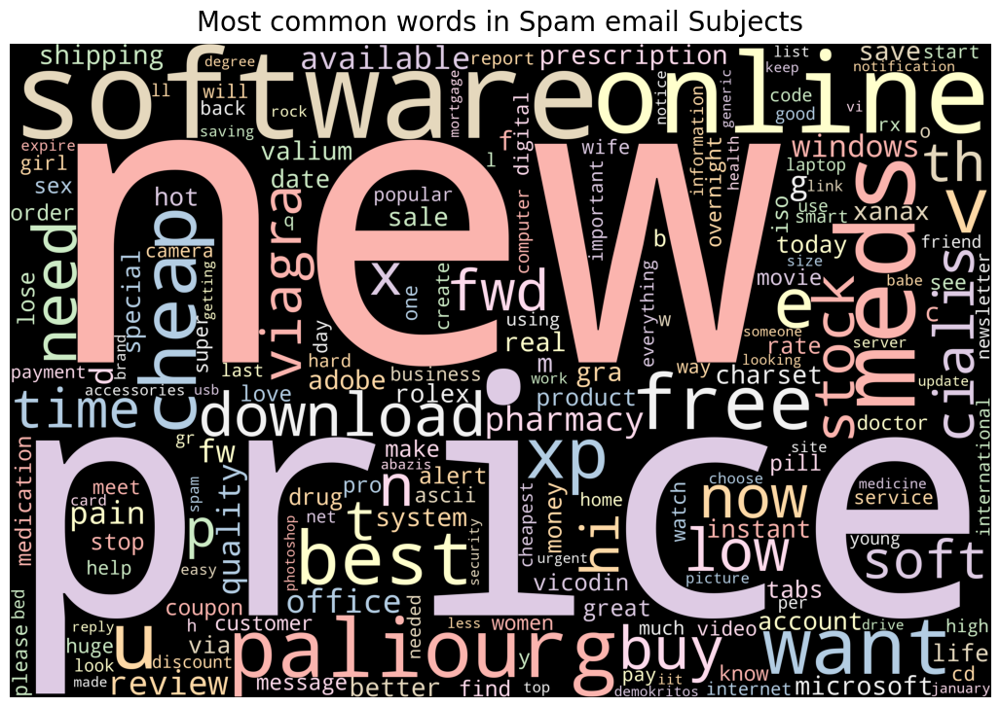

In [30]:
#plotting word cloud for Spam Subject corpus
Spam_Subject_wordcloud = make_wordcloud (Subject_corpus_spam , STOPWORDS)
plt.figure(figsize=(13, 13))
plt.title("Most common words in Spam email Subjects", fontdict={'size': 20, 'color': 'black', 
                                  'verticalalignment': 'bottom'})
plt.imshow(Spam_Subject_wordcloud)
plt.axis("off")
plt.show()

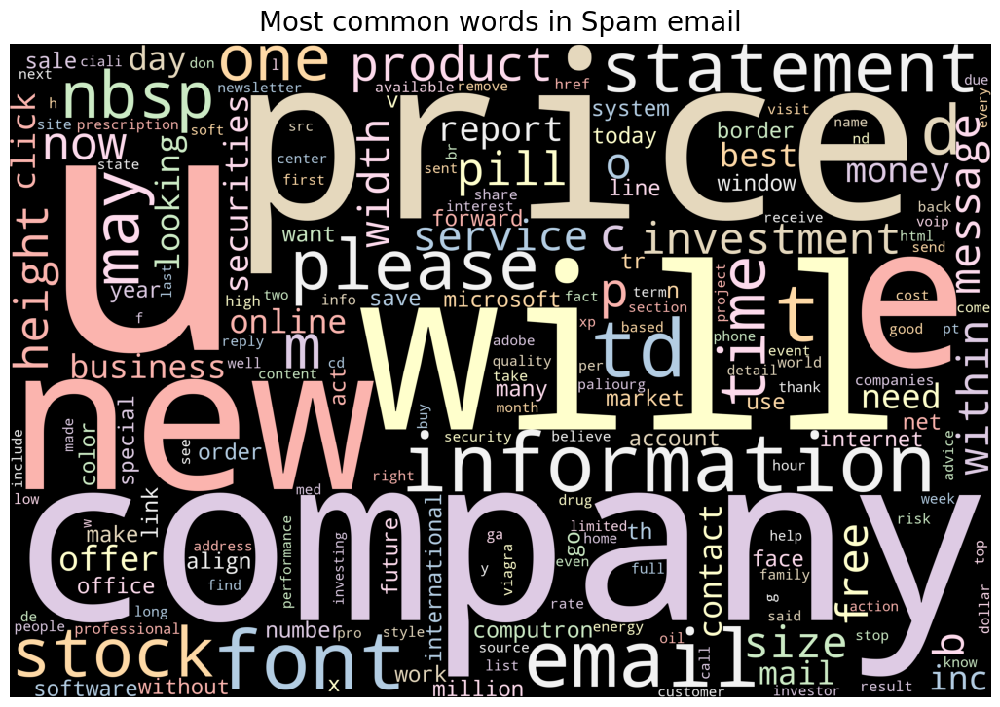

In [31]:
#plotting word cloud for Spam Text corpus
Spam_Text_wordcloud = make_wordcloud (Text_corpus_spam , STOPWORDS)
plt.figure(figsize=(13, 13))
plt.title("Most common words in Spam email", fontdict={'size': 20, 'color': 'black', 
                                  'verticalalignment': 'bottom'})
plt.imshow(Spam_Text_wordcloud)
plt.axis("off")
plt.show()

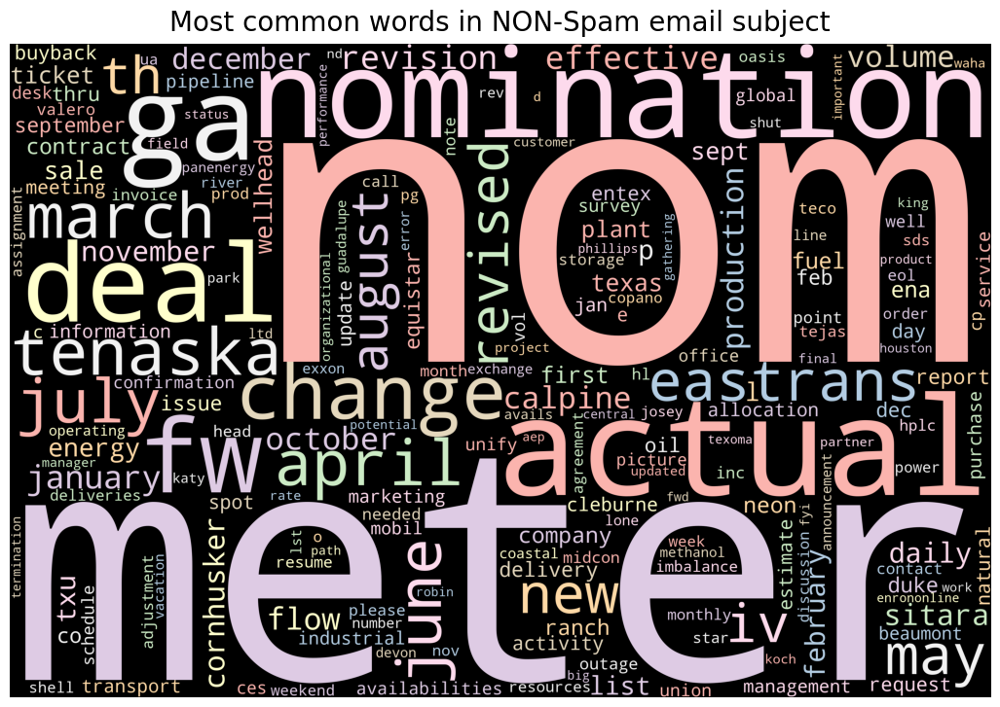

In [32]:
#plotting word cloud for Non Spam Subject corpus
Non_Spam_Subject_wordcloud = make_wordcloud (Subject_corpus_non_spam , STOPWORDS)
plt.figure(figsize=(13, 13))
plt.title("Most common words in NON-Spam email subject", fontdict={'size': 20, 'color': 'black', 
                                  'verticalalignment': 'bottom'})
plt.imshow(Non_Spam_Subject_wordcloud)
plt.axis("off")
plt.show()

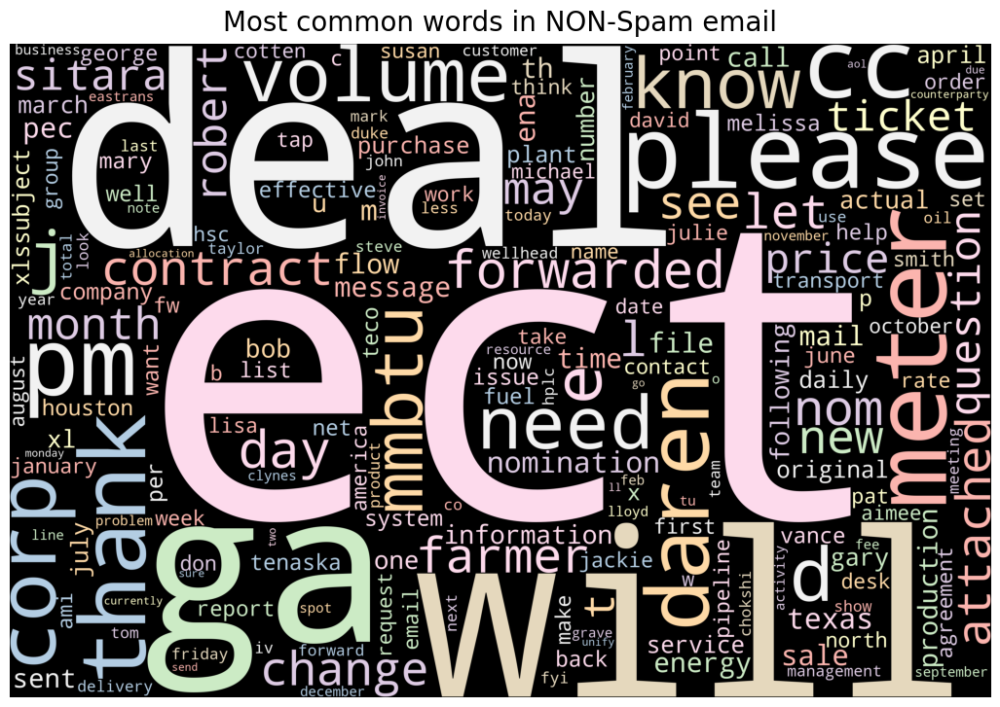

In [33]:
#plotting word cloud for Non Spam Text corpus
Non_Spam_Subject_wordcloud = make_wordcloud (Text_corpus_non_spam , STOPWORDS)
plt.figure(figsize=(13, 13))
plt.title("Most common words in NON-Spam email", fontdict={'size': 20, 'color': 'black', 
                                  'verticalalignment': 'bottom'})
plt.imshow(Non_Spam_Subject_wordcloud)
plt.axis("off")
plt.show()

In [34]:
#create a corpus conatininga all the email text 
Email_text_corpus = []
for line in Email_dataset['Email_text']:
    words = line.split(" ")
    Email_text_corpus.append(words)

In [35]:
#create a word2vec model for words in email text 
model = Word2Vec(Email_text_corpus, min_count=1, vector_size=56)

In [36]:
X = model.wv[model.wv.key_to_index ]
pca = PCA(n_components=2)
result = pca.fit_transform(X)
pca_df = pd.DataFrame(result, columns = ['x','y'])

In [37]:
#visualizing the corpus as a word vector
N = 1000000
words = list(model.wv.key_to_index)
fig = go.Figure(data=go.Scattergl(
   x = pca_df['x'],
   y = pca_df['y'],
   mode='markers',
   marker=dict(
       color=np.random.randn(N),
       colorscale='Viridis',
       line_width=1
   ),
   text=words,
   textposition="bottom center"
))

fig.show()

In [38]:
Email_dataset.head()

,Email_text,Email_Subject,Labels
0,subject enron methanol meter 988291\r\nthis...,enron methanol meter 988291,0
1,subject hpl nom for january 9 2001\r\n see at...,hpl nom for january 9 2001,0
2,subject neon retreat\r\nho ho ho we re aroun...,neon retreat,0
3,subject photoshop windows office cheap mai...,photoshop windows office cheap main trending,1
4,subject re indian springs\r\nthis deal is to ...,re indian springs,0


In [39]:
def sigmoid(x):
    return 1 / (1 + np.exp(-x))

In [40]:
def cost_function(h, y):
    return (-y * np.log(h + 1e-10) - (1 - y) * np.log(1 - h + 1e-10)).mean()

In [41]:
def gradient_descent(X, h, y):
    return np.dot(X.T, (h - y)) / y.shape[0]

In [42]:
def update_weight_loss(weight, learning_rate, gradient):
    return weight - learning_rate * gradient

In [43]:
X = Email_dataset['Email_text']
y = Email_dataset['Labels'].values

In [44]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [45]:
# Fit the CountVectorizer on your training data
vectorizer = CountVectorizer()
X_train = vectorizer.fit_transform(X_train).toarray()

# Transform your test data using the same vectorizer
X_test = vectorizer.transform(X_test).toarray()

In [46]:
num_iter = 1000
learning_rate = 0.1
weight = np.zeros(X_train.shape[1])

In [47]:
costs = []

In [48]:
for i in range(num_iter):
    z = np.dot(X_train, weight)
    h = sigmoid(z)
    gradient = gradient_descent(X_train, h, y_train)
    weight = update_weight_loss(weight, learning_rate, gradient)
    
    if(i % 100 == 0):
        z = np.dot(X_train, weight)
        h = sigmoid(z)
        cost = cost_function(h, y_train)
        costs.append(cost)
        print(f'cost: {cost} \t')

cost: 0.7509669787971328 	
cost: 0.18734134501939415 	
cost: 0.1445951701585873 	
cost: 0.12256923805243573 	
cost: 0.10836375095115418 	
cost: 0.09818415379577798 	
cost: 0.09041711053729154 	
cost: 0.08423253028308686 	
cost: 0.07915195028333213 	
cost: 0.07487775558765757 	


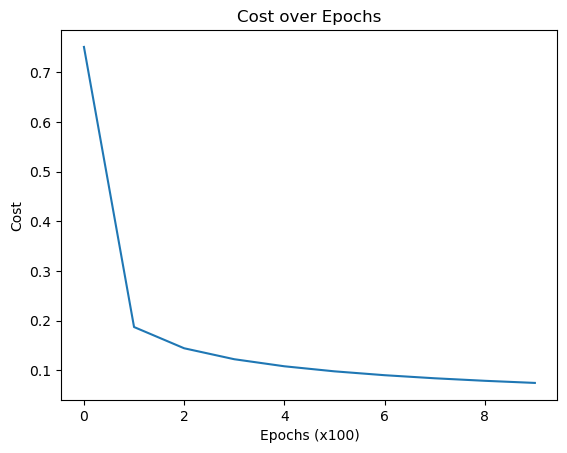

In [49]:
plt.plot(costs)
plt.xlabel('Epochs (x100)')
plt.ylabel('Cost')
plt.title('Cost over Epochs')
plt.show()

In [50]:
final_pred = sigmoid(np.dot(X_test, weight))
y_pred = final_pred.round()

In [51]:
print('Classification Report:')
print(classification_report(y_test, y_pred))

Classification Report:
              precision    recall  f1-score   support

           0       0.99      0.98      0.98       742
           1       0.94      0.97      0.96       293

    accuracy                           0.97      1035
   macro avg       0.97      0.97      0.97      1035
weighted avg       0.98      0.97      0.97      1035

